## Foursquare Places

La **API** de **Foursquare Places** nos permite retornar información de lugares, tiendas, restaurantes, museos...

Para poder usar la **API** vamos a necesitar tener un **`API_KEY`**, una llave única de 48 caracteres que nos va a permitir hacer llamadas y retornar información.

Para tener una **`API_KEY`** es necesario registrarse en la página de **Foursquare** como **desarrolladores** e iniciar un proyecto.

_**Foursquare Developers**_: https://developer.foursquare.com/


_**Documentación**_: https://developer.foursquare.com/reference/place-search


### Endpoints

En **Foursquare Places** tenemos diferentes endpoints, comenzaremos con **Search**:

```html
https://api.foursquare.com/v3/places/search
```
Este endpoint nos retorna información sobre lugares, como: ubicación, nombre, latitud y longitud, categoría, entre otras cosas.

Para hacer la búsqueda vamos a añadir los siguiente parámetros:
- **query** : **string**
    - A string to be matched against all content for this place, including but not limited to venue name, category, taste, and tips. PARA NO CERRARNOS EN CALLES SOLAMENTE, SINO PLAZAS, CENTROS..


- **ll** : **string**
    - The latitude/longitude around which to retrieve place information. This must be specified as latitude,longitude (e.g., ll=41.8781,-87.6298). APARTIR DE DONDE QUEREMOS QUE AMPLIE LA BUSQUEDA


- **radius** : **int32**
    - Defines the distance (in meters) within which to bias place results. The maximum allowed radius is 100,000 meters. Radius is used with ll or ip biased geolocation only.


- **categories** : **string**
    - Filters the response and returns FSQ Places matching the specified categories. Supports multiple Category IDs, separated by commas. For a complete list of Foursquare Category IDs, refer to the [Category Taxonomy](https://developer.foursquare.com/docs/categories) page.


- **chains** : **string**
    - Filters the response and returns FSQ Places matching the specified chains. Supports multiple chain IDs, separated by commas. FILTRO


- **exclude_chains** : **string** EXCLUIR ALGO
    - Filters the response and returns FSQ Places not matching any of the specified chains. Supports multiple chain IDs, separated by commas.


- **exclude_all_chains** : **boolean**
    - Filters the response by only returning FSQ Places that are not known to be part of any chain.


- **fields** : **string**
    - Indicate which fields to return in the response, separated by commas. If no fields are specified, all Core Fields are returned by default. For a complete list of returnable fields, refer to the [Response Fields](https://developer.foursquare.com/reference/response-fields) page.


- **min_price** : **int32** MINIMO DE PRECIO
    - Restricts results to only those places within the specified price range. Valid values range between 1 (most affordable) to 4 (most expensive), inclusive.


- **max_price** : **int32**
    - Restricts results to only those places within the specified price range. Valid values range between 1 (most affordable) to 4 (most expensive), inclusive.


- **open_at** : **string**
    - Support local day and local time requests through this parameter. To be specified as DOWTHHMM (e.g., 1T2130), where DOW is the day number 1-7 (Monday = 1, Sunday = 7) and time is in 24 hour format. Places that do not have opening hours will not be returned if this parameter is specified.


- **open_now** : **boolean**
    - Restricts results to only those places that are open now. Places that do not have opening hours will not be returned if this parameter is specified.


- **ne** : **string**
    - The latitude/longitude representing the north/east points of a rectangle. Must be used with sw parameter to specify a rectangular search box.


- **sw** : **string**
    - The latitude/longitude representing the south/west points of a rectangle. Must be used with ne parameter to specify a rectangular search box.


- **near** : **string**
    - A string naming a locality in the world (e.g., "Chicago, IL"). If the value is not geocodable, returns an error.


- **sort** : **string**
    - Specifies the order in which results are listed. Possible values are:

        - relevance (default)
        - rating
        - distance


- **limit** : **int32**
    - The number of results to return, up to 50. Defaults to 10. LIMITAR RESULTADO


- **session_token** : **string**
    - A user-generated token to identify a session for billing purposes. Learn more about session tokens.  ACCESO AUTENTIFICACION

In [1]:
import numpy as np
import pandas as pd

import requests
from pprint import pprint

import folium

In [9]:
with open ('src/credenciales.txt', 'r') as file:  #las credenciales no deberian ponerse en un notebook ni en un repositorio
    secrets = file.read()                               #creamos un archivo txt con nuestras credenciales poner en git ignore para que no suba al repo el archivo de credenciales


In [10]:
# Credenciales #asi deberiamos de introducir las credenciales en nuestro codigo para que nadie  use tus credenciales

credentials = (
    {
    secreto.split(' = ')[0]:secreto.split(' = ')[1] 
    for secreto in secrets.split('\n')
    }
)


In [12]:
credentials['clave_api']

'fsq3z8HMV0uS3MAiQceg/urTQowxI9SExHEZEtdjgvSTYgk='

In [13]:
def get_secrets(path:str)->dict:
    '''
    This functions receives a text file with the secrets of an API, and returns it
    '''
    with open (path, 'r') as file:
        secrets = file.read()
    credentials = (
        {
        secreto.split(' = ')[0]:secreto.split(' = ')[1] 
        for secreto in secrets.split('\n')
        }
    )
    
    return credentials

In [15]:
credentials = get_secrets('src/credenciales.txt')
credentials

{'Client_Secret': '0545M5NURCW05042AZG31XZBA3V5FKIHTQKCXTLCGPX33KHJ',
 'Client_Id': '5T2S1A4VLBSGDFL32GLNLLZKICVPJJZYHCHBZRSYXE1ZVMAW',
 'clave_api': 'fsq3z8HMV0uS3MAiQceg/urTQowxI9SExHEZEtdjgvSTYgk='}

In [18]:
# Llamada al API

# Base del Endpoint
search_url = "https://api.foursquare.com/v3/places/search"

# Parametros
query = "campings"

near = "spain"

# Endpoint
endpoint = f"{search_url}?query={query}&near={near}&limit=50"

print(f"Endpoint: {endpoint}")

# Headers
# Para poder usar el API tenemos que autenticarnos usando el "API_KEY"
# Por eso debemos crear una nueva variable "headers"
# Este diccionario tendrá la información de los permisos necesarios.

headers = {"accept"        : "application/json", 
           "Authorization" : credentials['clave_api']}

headers

# Request
# Agregamos el parámetro "headers"
response = requests.get(url = endpoint, headers = headers)

print(f"response: {response.status_code}")

print(response.json())

Endpoint: https://api.foursquare.com/v3/places/search?query=campings&near=spain&limit=50
response: 200
{'results': [{'fsq_id': '4cb8c5bfadcd5481c76d18a2', 'categories': [{'id': 16008, 'name': 'Campground', 'short_name': 'Campground', 'plural_name': 'Campgrounds', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/campground_', 'suffix': '.png'}}], 'chains': [], 'closed_bucket': 'VeryLikelyOpen', 'distance': 108020, 'geocodes': {'main': {'latitude': 40.95009, 'longitude': -3.72961}, 'roof': {'latitude': 40.95009, 'longitude': -3.72961}}, 'link': '/v3/places/4cb8c5bfadcd5481c76d18a2', 'location': {'address': 'Finca el Tercio Nuevo, s/n', 'admin_region': 'Comunidad de Madrid', 'country': 'ES', 'cross_street': 'Finca El Tercio Nuevo S/N', 'formatted_address': 'Finca el Tercio Nuevo, s/n (Finca El Tercio Nuevo S/N), 28739 Lozoya Madrid', 'locality': 'Gargantilla del Lozoya', 'postcode': '28739', 'region': 'Madrid'}, 'name': 'Monte Holiday Ecoturismo', 'related_places'

In [22]:
# Usando pprint

pprint(response.json()["results"][3])

{'categories': [{'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/campground_',
                          'suffix': '.png'},
                 'id': 16008,
                 'name': 'Campground',
                 'plural_name': 'Campgrounds',
                 'short_name': 'Campground'}],
 'chains': [],
 'closed_bucket': 'VeryLikelyOpen',
 'distance': 223045,
 'fsq_id': '4c38aeb618e72d7fddc318f5',
 'geocodes': {'main': {'latitude': 40.412157, 'longitude': -1.42752},
              'roof': {'latitude': 40.412157, 'longitude': -1.42752}},
 'link': '/v3/places/4c38aeb618e72d7fddc318f5',
 'location': {'address': 'Camino de Gea, s/n',
              'admin_region': 'Aragón',
              'country': 'ES',
              'formatted_address': 'Camino de Gea, s/n, 44100 Teruel Aragón',
              'locality': 'Teruel',
              'postcode': '44100',
              'region': 'Aragón'},
 'name': 'Camping Ciudad de Albarracin',
 'related_places': {},
 'timezone': 'Europe/

In [23]:
pprint(response.json())

{'context': {'geo_bounds': {'circle': {'center': {'latitude': 40.0,
                                                  'longitude': -4.0},
                                       'radius': 714039}}},
 'results': [{'categories': [{'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/campground_',
                                       'suffix': '.png'},
                              'id': 16008,
                              'name': 'Campground',
                              'plural_name': 'Campgrounds',
                              'short_name': 'Campground'}],
              'chains': [],
              'closed_bucket': 'VeryLikelyOpen',
              'distance': 108020,
              'fsq_id': '4cb8c5bfadcd5481c76d18a2',
              'geocodes': {'main': {'latitude': 40.95009,
                                    'longitude': -3.72961},
                           'roof': {'latitude': 40.95009,
                                    'longitude': -3.72961}},
           

In [24]:
# Por defecto, Foursquare nos retorna los primero 50 resultados

len(response.json()["results"])

50

In [25]:
# Usando "url_params"

search_url = "https://api.foursquare.com/v3/places/search"

# "url_params" es un diccionario que tendrá todos los parámetros de nuestra búsqueda
# Nos ayuda a tener el código más limpio y es fácil de utilizar al momento de hacer la llamada a la API.

url_params = {"query"    : "campings",
              "ll"       : "40.4167,-3.7042",
              "open_now" : None,
              "limit"    : 50,
              "radius"   : 100_000, #100km
              "category" : None}

headers = {"accept"       : "application/json", 
           "Authorization": credentials['clave_api']}

# Como ahora usamos una variable para los parámetros, debemos agregarlos con el parámetro "params"
response = requests.get(url = search_url, params = url_params, headers = headers)

# El método ".get()" le dará el formato a el endpoint usando los "key : value" del diccionario "url_params"
print(f"endpoint: {response.url}")

print(f"response: {response.status_code}")

print(response.json())

endpoint: https://api.foursquare.com/v3/places/search?query=campings&ll=40.4167%2C-3.7042&limit=50&radius=100000
response: 200
{'results': [{'fsq_id': '4cb8c5bfadcd5481c76d18a2', 'categories': [{'id': 16008, 'name': 'Campground', 'short_name': 'Campground', 'plural_name': 'Campgrounds', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/campground_', 'suffix': '.png'}}], 'chains': [], 'closed_bucket': 'VeryLikelyOpen', 'distance': 59308, 'geocodes': {'main': {'latitude': 40.95009, 'longitude': -3.72961}, 'roof': {'latitude': 40.95009, 'longitude': -3.72961}}, 'link': '/v3/places/4cb8c5bfadcd5481c76d18a2', 'location': {'address': 'Finca el Tercio Nuevo, s/n', 'admin_region': 'Comunidad de Madrid', 'country': 'ES', 'cross_street': 'Finca El Tercio Nuevo S/N', 'formatted_address': 'Finca el Tercio Nuevo, s/n (Finca El Tercio Nuevo S/N), 28739 Lozoya Madrid', 'locality': 'Gargantilla del Lozoya', 'postcode': '28739', 'region': 'Madrid'}, 'name': 'Monte Holiday Ecotur

In [26]:
pprint(response.json())

{'context': {'geo_bounds': {'circle': {'center': {'latitude': 40.4167,
                                                  'longitude': -3.7042},
                                       'radius': 100000}}},
 'results': [{'categories': [{'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/campground_',
                                       'suffix': '.png'},
                              'id': 16008,
                              'name': 'Campground',
                              'plural_name': 'Campgrounds',
                              'short_name': 'Campground'}],
              'chains': [],
              'closed_bucket': 'VeryLikelyOpen',
              'distance': 59308,
              'fsq_id': '4cb8c5bfadcd5481c76d18a2',
              'geocodes': {'main': {'latitude': 40.95009,
                                    'longitude': -3.72961},
                           'roof': {'latitude': 40.95009,
                                    'longitude': -3.72961}},
      

In [27]:
response.json()["results"][0].get("fsq_idqwerghjk") #extraer fotos, se necesita!

Ya con la información en una variable, podemos darle formato de **DataFrame**.

In [28]:
data = response.json()

data_df = list()

for r in data["results"]:

    fsq_id = r["fsq_id"]
    category = r["categories"][0]["name"]
    latitude = r["geocodes"]["main"]["latitude"]
    longitude = r["geocodes"]["main"]["longitude"]
    location = r["location"]["formatted_address"]
    postcode = r["location"].get("postcode")
    name = r["name"]
    
    data_df.append([name, category, latitude, longitude, location, postcode, fsq_id])
    
df = pd.DataFrame(data = data_df, columns = ["name", "category", "latitude", "longitude", "location", "postcode", "fsq_id"])

df

,name,category,latitude,longitude,location,postcode,fsq_id
0,Monte Holiday Ecoturismo,Campground,40.950090,-3.729610,"Finca el Tercio Nuevo, s/n (Finca El Tercio Nu...",28739,4cb8c5bfadcd5481c76d18a2
1,Ciudad Deportiva Rayo de Majadahonda,Campground,40.455732,-3.864310,28222 Majadahonda Madrid,28222,4dd0147bd164679b8d280e5e
2,Camping el Escorial,Campground,40.623850,-4.099999,"Carretera de Guadarrama al Escorial M-600, Km ...",28200,4b6432b9f964a520a8a32ae3
3,Camping Riaza,Campground,41.272151,-3.479359,"Carretera de la Estación, s/n, 40500 Riaza Cas...",40500,4dd6c20145ddced82075ee55
4,Camping Pico de la Miel,Campground,40.858446,-3.616126,"Calle del Camping, s/n, 28751 La Cabrera Madrid",28751,4bb33ce414cfd13adcc015ab
5,Meeting Point,Campground,40.416005,-3.712745,"Calle del Factor, 5, 28013 Madrid Madrid",28013,5ef20c78631a0a00085f35d5
6,Encuadernacion y Restauracion Luna,Campground,40.420426,-3.712261,"Carretera Nacional N-230, Km 174,5, 28013 Madr...",28013,82879661603e492e8a0a21c5
7,Merendero Casa de Campo,Campground,40.412040,-3.778798,,None,4ead63c10aaf9e9a24185761
8,No Te Lo Voy a Decir,Campground,40.473594,-3.682106,,None,4f55c333e4b0fd6957be2743
9,Aventurarte,Campground,40.469586,-3.658723,"Gran Vía de Hortaleza, 5, 28033 Madrid Madrid",28033,5fe099dc8644a35570f6e7d2


In [32]:
df2 = df.dropna()

Ahora, podemos mostrar toda esta información en un mapa de **Folium**.

In [36]:
import folium

mad_ll = (40.4167, -3.7042) #las mismas que antes, es el centro

mad_map = folium.Map(location = mad_ll, zoom_start = 9)

stadiums = folium.map.FeatureGroup()

for lat, lng, name, category in zip(df["latitude"], df["longitude"], df["name"], df["category"]):
    
    stadiums.add_child(folium.Marker(location = [lat, lng],
                                    popup    = f"{name}, </br><b>{category}</b>"))
    
mad_map.add_child(stadiums)

mad_map

### Endpoints

**Details**: Retorna información de un lugar, utilizando su **`fsq_id`**:

```html
https://api.foursquare.com/v3/places/{fsq_id}
```
_**Documentación**_: https://developer.foursquare.com/reference/place-details

No tiene parámetros, las llamadas las hacemos usando directamente el **`fsq_id`**.

La información que retorna es la misma que la retornada por **Search**, solo que es la información de un único lugar. 

In [47]:
#devolver detalles de una sola localizacion a traves de su id
fsq_id = "4f55c333e4b0fd6957be2743"

details_url = f"https://api.foursquare.com/v3/places/{fsq_id}"

headers = {"accept": "application/json", 
           "Authorization": credentials['clave_api']}

response = requests.get(url = details_url, headers = headers)

print(f"endpoint: {response.url}")

print(f"response: {response.status_code}")

print(response.json())

endpoint: https://api.foursquare.com/v3/places/4f55c333e4b0fd6957be2743
response: 200
{'fsq_id': '4f55c333e4b0fd6957be2743', 'categories': [{'id': 16008, 'name': 'Campground', 'short_name': 'Campground', 'plural_name': 'Campgrounds', 'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/parks_outdoors/campground_', 'suffix': '.png'}}], 'chains': [], 'closed_bucket': 'LikelyOpen', 'geocodes': {'main': {'latitude': 40.473594, 'longitude': -3.682106}, 'roof': {'latitude': 40.473594, 'longitude': -3.682106}}, 'link': '/v3/places/4f55c333e4b0fd6957be2743', 'location': {'country': 'ES', 'cross_street': '', 'formatted_address': ''}, 'name': 'No Te Lo Voy a Decir', 'related_places': {}, 'timezone': 'Europe/Madrid'}


### Endpoints

**Photos**: Retorna imágenes de un lugar, utilizando su **`fsq_id`**:

```html

https://api.foursquare.com/v3/places/{fsq_id}/photos
```

_**Documentación**_: https://developer.foursquare.com/reference/place-photos

Tiene 3 parámetros para ordenar y filtrar los resultados:

- **limit : int32**
    - The specified number of photos per page. Returns 10 photos by default, up to a maximum number of 50.


- **sort : string**
    - Specifies the order in which results are listed. Possible values are:

        - popular (default) - sorts results based on their popularity among Foursquare users
        - newest - sorts results from most recently added to least recently added


- **classifications : string**
    - Restricts the results to photos matching the specified classifications, separated by a comma. Possible values are:

        - food - photos of food
        - indoor - photos of indoors
        - menu - photos of menus
        - outdoor - photos of storefronts, outdoors, and exteriors
        
        
_**Para manipular las imágenes de Foursquare**_: https://developer.foursquare.com/reference/places-photos-guide#assembling-a-photo-url

In [ ]:
no_telovoy_adecir = "4adcda38f964a5205d3c21e3"

In [50]:
#pedir fotos

fsq_id = "4b6432b9f964a520a8a32ae3"

url_params = {"limit"           : 50,
              "sort"            : "newest", #ordenar por las mas nuevas
              "classifications" : None} #si queremos fotos de dentro de las instalaciones o fuera o del menú o de la comida

details_url = f"https://api.foursquare.com/v3/places/{fsq_id}/photos"

headers = {"accept": "application/json", 
           "Authorization":credentials['clave_api']}

response = requests.get(url = details_url, params = url_params, headers = headers)

print(f"endpoint: {response.url}")

print(f"response: {response.status_code}")

print(response.json()) #devuelve serie de png

endpoint: https://api.foursquare.com/v3/places/4b6432b9f964a520a8a32ae3/photos?limit=50&sort=newest
response: 200
[{'id': '608e8fe8170e876e14f8dacf', 'created_at': '2021-05-02T11:41:28.000Z', 'prefix': 'https://fastly.4sqi.net/img/general/', 'suffix': '/17509642_gKkmi6AlpdAjBPa86SwZbLYubXpJbB0WRYjFfUsJS2M.jpg', 'width': 1440, 'height': 1920}, {'id': '577fedc8498e425c0a203e56', 'created_at': '2016-07-08T18:15:36.000Z', 'prefix': 'https://fastly.4sqi.net/img/general/', 'suffix': '/175072597_uNxZ3yitr0XBmEvfu1jMzvT3Bh8z20NmaJgb7DozagE.jpg', 'width': 540, 'height': 960}, {'id': '57419b1a498ed44f258991d5', 'created_at': '2016-05-22T11:42:18.000Z', 'prefix': 'https://fastly.4sqi.net/img/general/', 'suffix': '/253810_N8bkjV40xYXqAR8LZ1arSr1B9-ymQL_CuC9WcuMQjUE.jpg', 'width': 960, 'height': 540}, {'id': '54a54d16498eea12d05ca2a2', 'created_at': '2015-01-01T13:35:18.000Z', 'prefix': 'https://fastly.4sqi.net/img/general/', 'suffix': '/670958_yhCom1QsUG1tzW8194l8lLk5Tkv3WFWwgXDX2DG6qO0.jpg', 'wid

In [51]:
response.json()

[{'id': '608e8fe8170e876e14f8dacf',
  'created_at': '2021-05-02T11:41:28.000Z',
  'prefix': 'https://fastly.4sqi.net/img/general/',
  'suffix': '/17509642_gKkmi6AlpdAjBPa86SwZbLYubXpJbB0WRYjFfUsJS2M.jpg',
  'width': 1440,
  'height': 1920},
 {'id': '577fedc8498e425c0a203e56',
  'created_at': '2016-07-08T18:15:36.000Z',
  'prefix': 'https://fastly.4sqi.net/img/general/',
  'suffix': '/175072597_uNxZ3yitr0XBmEvfu1jMzvT3Bh8z20NmaJgb7DozagE.jpg',
  'width': 540,
  'height': 960},
 {'id': '57419b1a498ed44f258991d5',
  'created_at': '2016-05-22T11:42:18.000Z',
  'prefix': 'https://fastly.4sqi.net/img/general/',
  'suffix': '/253810_N8bkjV40xYXqAR8LZ1arSr1B9-ymQL_CuC9WcuMQjUE.jpg',
  'width': 960,
  'height': 540},
 {'id': '54a54d16498eea12d05ca2a2',
  'created_at': '2015-01-01T13:35:18.000Z',
  'prefix': 'https://fastly.4sqi.net/img/general/',
  'suffix': '/670958_yhCom1QsUG1tzW8194l8lLk5Tkv3WFWwgXDX2DG6qO0.jpg',
  'width': 960,
  'height': 720,
  'classifications': ['food']},
 {'id': '544ac

In [52]:
data = response.json()

image_data = list()

for r in data:
    image_id = r["id"] #porque el id de mis fotos son numeros y deben de ser strings
    created_at = r["created_at"]
    prefix = r["prefix"] + "original" # Hay que agregar "original" al url para poder visualizarlo.
    suffix = r["suffix"]
    
    image_data.append([image_id, prefix + suffix, created_at])
    
df_image = pd.DataFrame(data = image_data, columns = ["id", "image_url", "created_at"])

df_image

,id,image_url,created_at
0,608e8fe8170e876e14f8dacf,https://fastly.4sqi.net/img/general/original/1...,2021-05-02T11:41:28.000Z
1,577fedc8498e425c0a203e56,https://fastly.4sqi.net/img/general/original/1...,2016-07-08T18:15:36.000Z
2,57419b1a498ed44f258991d5,https://fastly.4sqi.net/img/general/original/2...,2016-05-22T11:42:18.000Z
3,54a54d16498eea12d05ca2a2,https://fastly.4sqi.net/img/general/original/6...,2015-01-01T13:35:18.000Z
4,544aca84498e42091a492d98,https://fastly.4sqi.net/img/general/original/4...,2014-10-24T21:54:12.000Z
5,543ed201498e5840fa834611,https://fastly.4sqi.net/img/general/original/4...,2014-10-15T19:58:57.000Z
6,53d61800498e8d097552ff41,https://fastly.4sqi.net/img/general/original/5...,2014-07-28T09:29:36.000Z
7,52f52a8f498e9091b83dc6de,https://fastly.4sqi.net/img/general/original/3...,2014-02-07T18:48:47.000Z
8,52f4e36c498e81fad3583289,https://fastly.4sqi.net/img/general/original/3...,2014-02-07T13:45:16.000Z
9,5218afad498ee1061bd075b2,https://fastly.4sqi.net/img/general/original/3...,2013-08-24T13:05:49.000Z


In [53]:
for url in df_image["image_url"]:
    print(url)

https://fastly.4sqi.net/img/general/original/17509642_gKkmi6AlpdAjBPa86SwZbLYubXpJbB0WRYjFfUsJS2M.jpg
https://fastly.4sqi.net/img/general/original/175072597_uNxZ3yitr0XBmEvfu1jMzvT3Bh8z20NmaJgb7DozagE.jpg
https://fastly.4sqi.net/img/general/original/253810_N8bkjV40xYXqAR8LZ1arSr1B9-ymQL_CuC9WcuMQjUE.jpg
https://fastly.4sqi.net/img/general/original/670958_yhCom1QsUG1tzW8194l8lLk5Tkv3WFWwgXDX2DG6qO0.jpg
https://fastly.4sqi.net/img/general/original/477300_dGViHt66a6ts4JC4n-N6AHc2rx_quj06HlkFrg7YBhM.jpg
https://fastly.4sqi.net/img/general/original/477300_wUxzTydHMZhRazyopaf0_NPXkuBxjdUuyt9o7vFVf8w.jpg
https://fastly.4sqi.net/img/general/original/56727792_60AHjzkM1YSkHMPQbSXCzP97MhISIT9X5kMPxHkN26w.jpg
https://fastly.4sqi.net/img/general/original/39244222_vfqldUvUR5FaV3VBNDYRCATuZeI8QYY34AnEbynPYw8.jpg
https://fastly.4sqi.net/img/general/original/39244222_2AIKrAceuo-HjYHrEF0wzIaXuP-msWHLFrETYXHrZKo.jpg
https://fastly.4sqi.net/img/general/original/3549624_kKssbgbxI-2IyaLV6PkJpG7xNcL8Jz4oPDrQ

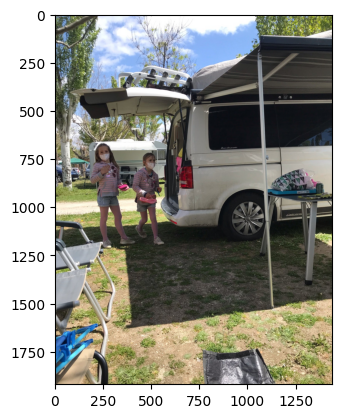

https://fastly.4sqi.net/img/general/original/17509642_gKkmi6AlpdAjBPa86SwZbLYubXpJbB0WRYjFfUsJS2M.jpg


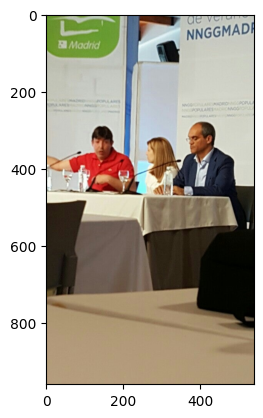

https://fastly.4sqi.net/img/general/original/175072597_uNxZ3yitr0XBmEvfu1jMzvT3Bh8z20NmaJgb7DozagE.jpg


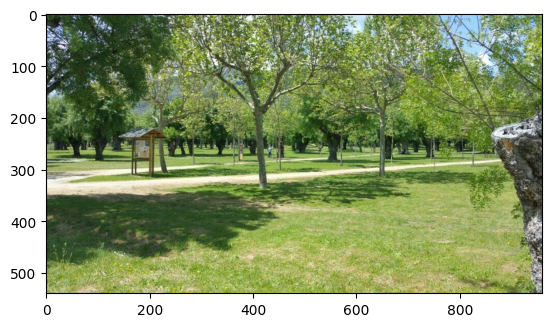

https://fastly.4sqi.net/img/general/original/253810_N8bkjV40xYXqAR8LZ1arSr1B9-ymQL_CuC9WcuMQjUE.jpg


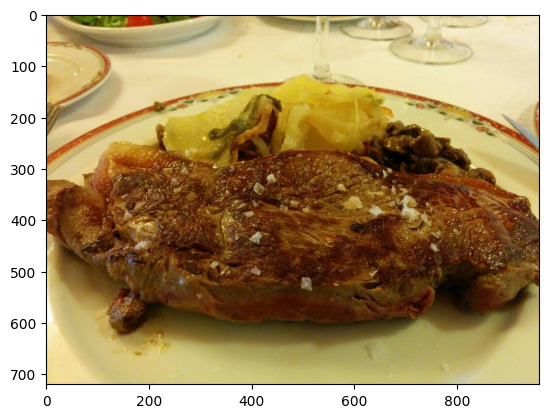

https://fastly.4sqi.net/img/general/original/670958_yhCom1QsUG1tzW8194l8lLk5Tkv3WFWwgXDX2DG6qO0.jpg


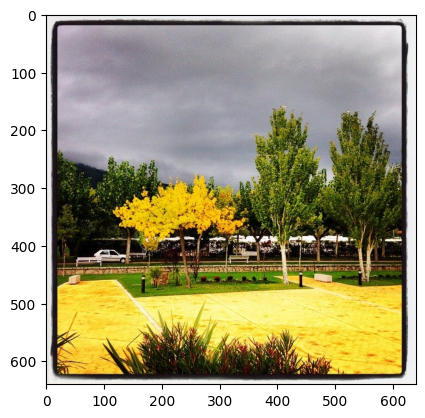

https://fastly.4sqi.net/img/general/original/477300_dGViHt66a6ts4JC4n-N6AHc2rx_quj06HlkFrg7YBhM.jpg


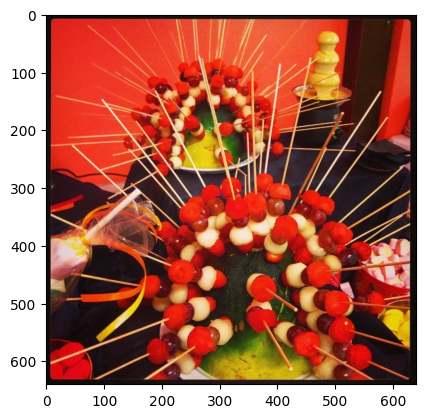

https://fastly.4sqi.net/img/general/original/477300_wUxzTydHMZhRazyopaf0_NPXkuBxjdUuyt9o7vFVf8w.jpg


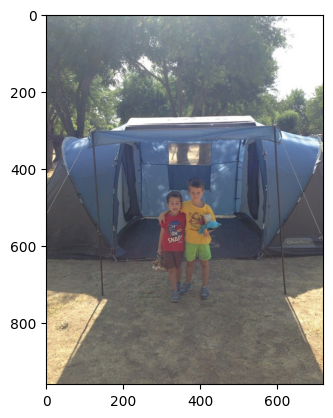

https://fastly.4sqi.net/img/general/original/56727792_60AHjzkM1YSkHMPQbSXCzP97MhISIT9X5kMPxHkN26w.jpg


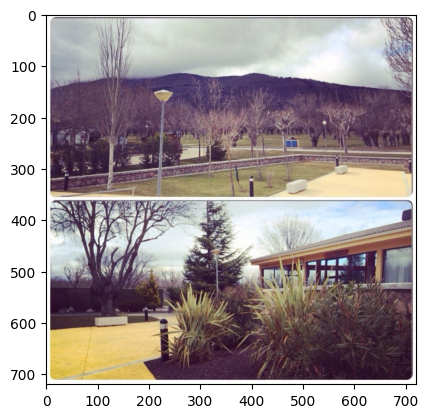

https://fastly.4sqi.net/img/general/original/39244222_vfqldUvUR5FaV3VBNDYRCATuZeI8QYY34AnEbynPYw8.jpg


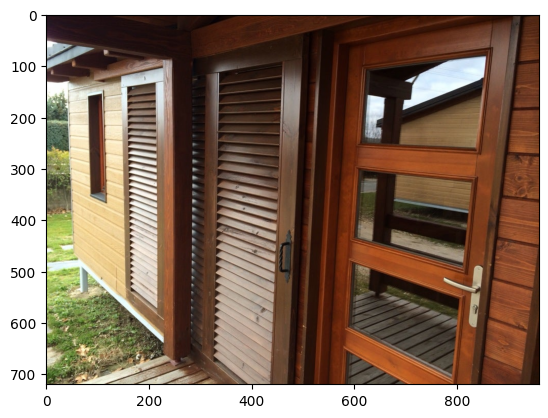

https://fastly.4sqi.net/img/general/original/39244222_2AIKrAceuo-HjYHrEF0wzIaXuP-msWHLFrETYXHrZKo.jpg


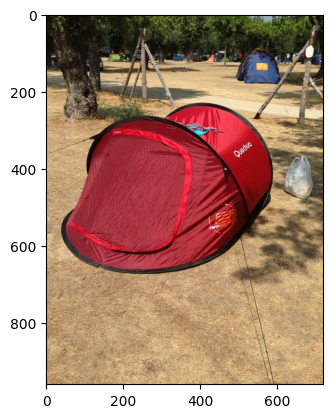

https://fastly.4sqi.net/img/general/original/3549624_kKssbgbxI-2IyaLV6PkJpG7xNcL8Jz4oPDrQ61ljKo0.jpg


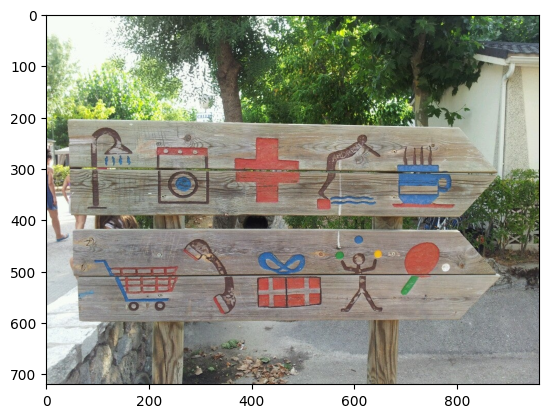

https://fastly.4sqi.net/img/general/original/17754231_mFb46Q80SND9Qt3f3gzdEOYRQKvVFsdnS6hfQ51ysrM.jpg


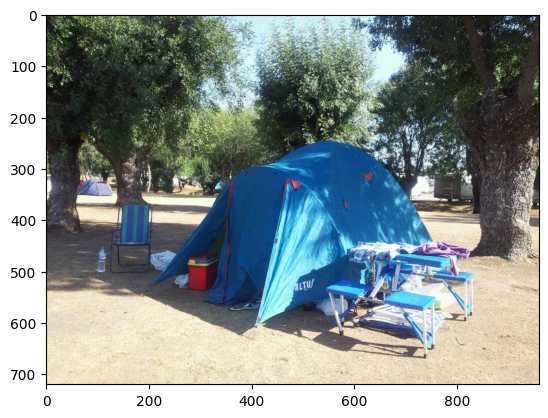

https://fastly.4sqi.net/img/general/original/16158661_4ZfOuBxiCrp0V-LA5wEEbkruQPnQHwxlmYtZxjtMEnc.jpg


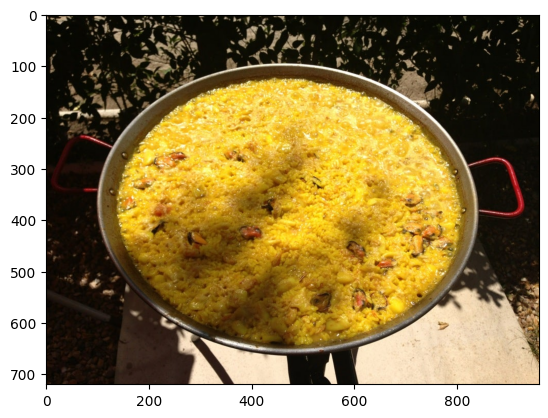

https://fastly.4sqi.net/img/general/original/3549624_qwsjHvB1zJFIE3DJMPXcTiV0MaZ6-t1kwgRZDeE0J-k.jpg


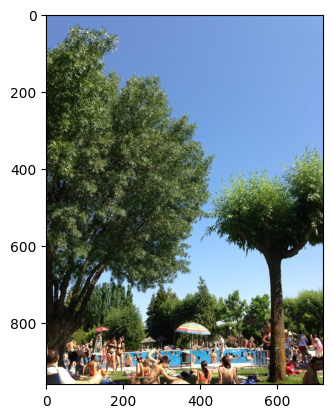

https://fastly.4sqi.net/img/general/original/57568684_aoTcv7cmkhxTjB8g4oLqTbVB11sUvbwOiQPO_P5ANOo.jpg


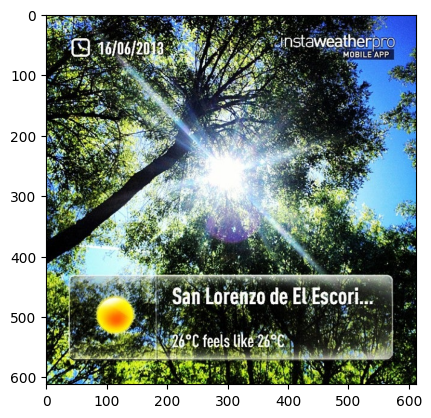

https://fastly.4sqi.net/img/general/original/3500641_u7thW_gxHsB-QkumL9cmxBgMGeaIG18JXYBJ4AFMKPU.jpg


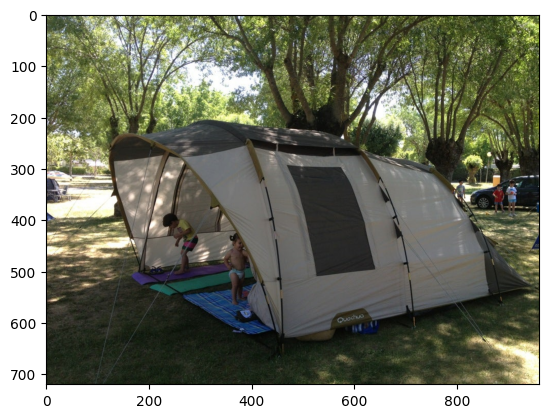

https://fastly.4sqi.net/img/general/original/3500641_FDzGzKqCESaG9KaTeCWhPdhDiqiwbPZNgpBAtDrsPMY.jpg


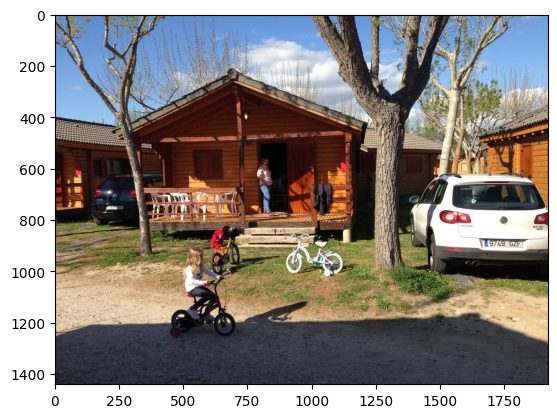

https://fastly.4sqi.net/img/general/original/16147608_cazmdtjmhVlyajayHz7ph5PQ4NfHLpVJ9q1CqQNOc70.jpg


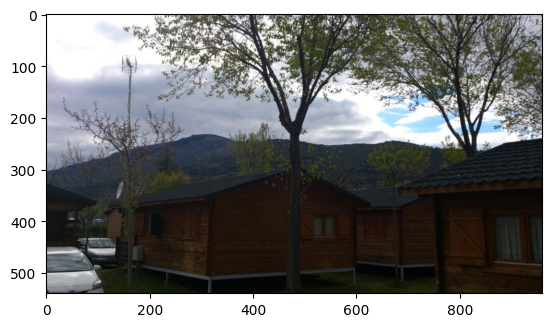

https://fastly.4sqi.net/img/general/original/43038156__wySNl2nLQ2KOeGYvhgLItruSIjlOOg74-48wJa_FbA.jpg


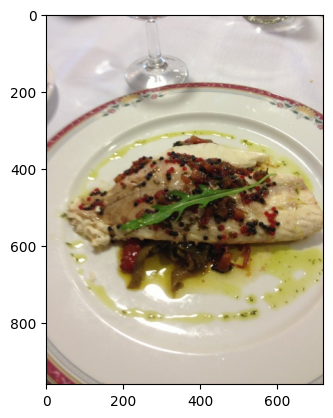

https://fastly.4sqi.net/img/general/original/48205198_0EwnO29kqMukgo5d8CNC8PFlGQR0_6KYrB78m0xg96k.jpg


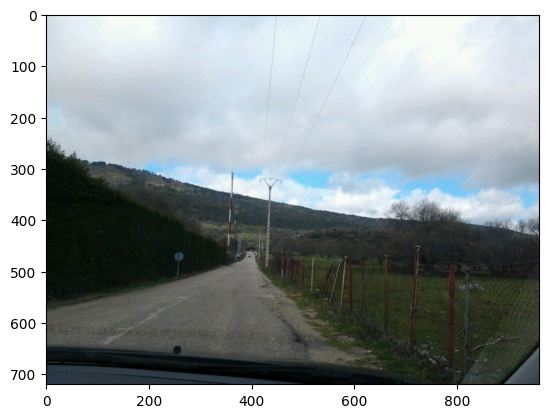

https://fastly.4sqi.net/img/general/original/50449503_Vvh4qgcOMRVS68LBhmKU-0TxLTAkZwzJAuGq9F2ZGzc.jpg


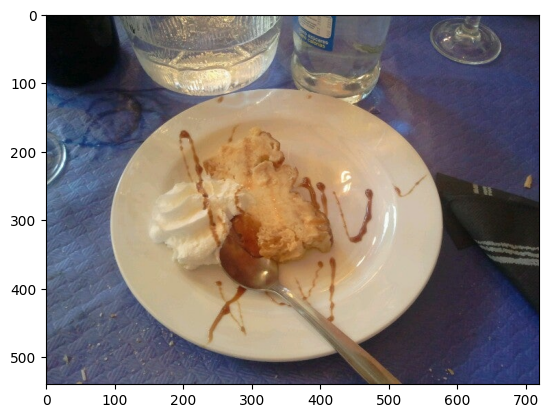

https://fastly.4sqi.net/img/general/original/21387236_goWp8EkAJRmEbR38p1xM7z__xfbiNJl7Jvm2ZhDsfxE.jpg


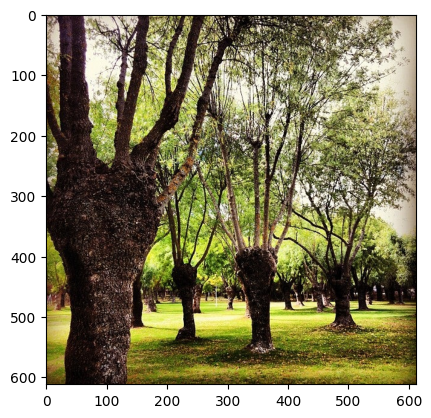

https://fastly.4sqi.net/img/general/original/14917342_kdegUw_W4PDZrEDQU42G3sBlAoviwKYtHijdntwM8H4.jpg


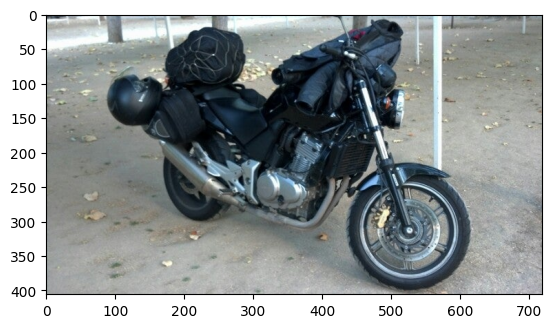

https://fastly.4sqi.net/img/general/original/36927426_eqVnoGA9SYvDK5yI91j64CIWlGrkFlQT6pWb0Ge1wD4.jpg


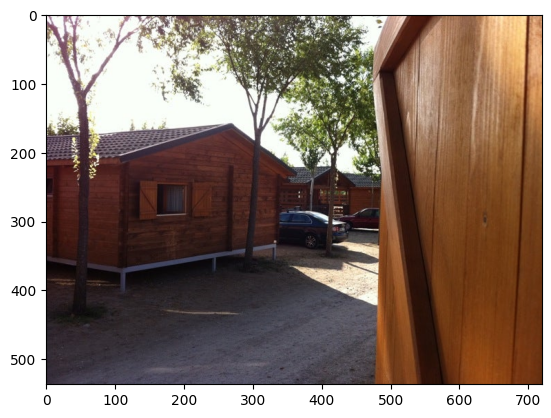

https://fastly.4sqi.net/img/general/original/5xPPsWvIt3KDP2v7LG58vitFyRbDvAdAr3mfurPuqqM.jpg


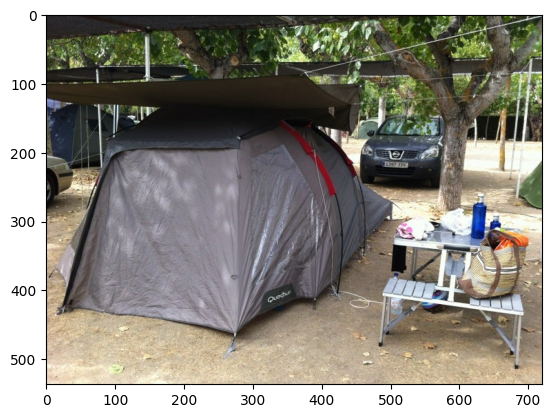

https://fastly.4sqi.net/img/general/original/1Y98DcniijZTFdvNBAZqgmtUSDivZLFOusxxZIJZA4s.jpg


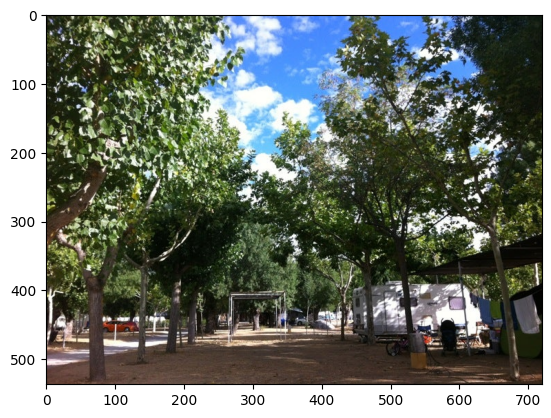

https://fastly.4sqi.net/img/general/original/KYus5qdefYTV5tjfQN9IOMmYHeEntpouN1a3OPkppHo.jpg


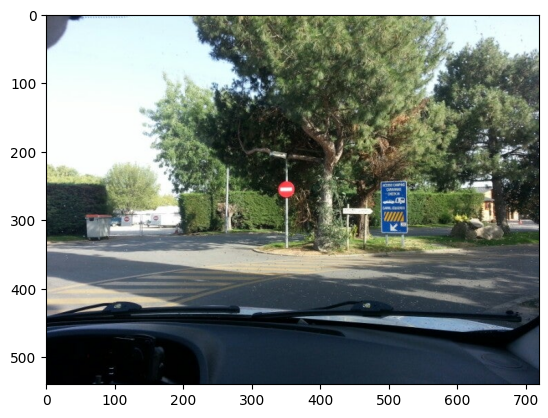

https://fastly.4sqi.net/img/general/original/xAB3MOpbLNmwJOJF-v40dzfFlKkctsttUbg2DG_7oI4.jpg


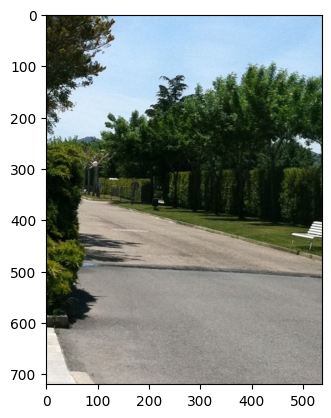

https://fastly.4sqi.net/img/general/original/SMYqzuWPGj1AYVgyDstFcVCbIjrVwMYFLpLxoiPWXKY.jpg


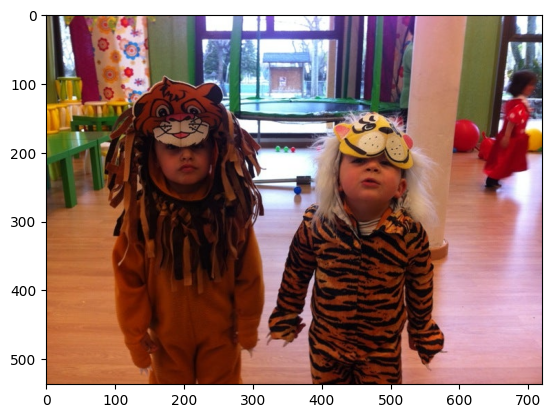

https://fastly.4sqi.net/img/general/original/kLfQlytPAxM2q9sjfADY83FIhBwP1RTzz02otyFBScc.jpg


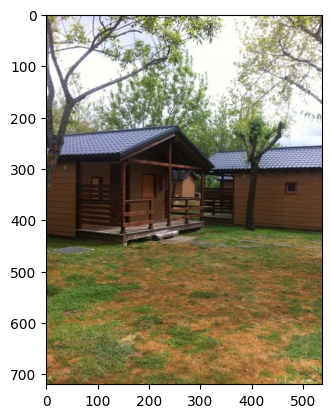

https://fastly.4sqi.net/img/general/original/K0B1IUOY4JISF3ZXV5K0PMFMMRRKUBX2J5HMBHOEDOORKHTW.jpg


In [54]:
import urllib
import matplotlib.pyplot as plt

for url in df_image["image_url"]:
    
    f = urllib.request.urlopen(url)

    a = plt.imread(f, format = f".{url.split('.')[-1]}")
    plt.imshow(a)
    plt.show()
    
    print(url)

### Endpoints

**Tips**: Retorna "tips" o reseñas de un lugar dejados por lo usuarios, utilizando su **`fsq_id`**:

```html
https://api.foursquare.com/v3/places/{fsq_id}/tips
```
_**Documentación**_: https://developer.foursquare.com/reference/place-tips

Tiene 3 parámetros para controlar la información que retornamos:
- **limit : int32**
    - The specified number of tips per page. Returns 10 tips by default, up to a maximum number of 50.


- **fields : string**
    - Indicate which fields to return in the response, separated by commas. Supported fields are:

        - id - the ID of the tip
        - created_at - when was the tip created
        - text - what does the tip actually say?
        - lang - what language was the tip created in
        
    Default fields if this param is omitted are "id", "created_at", and "text".


- **sort : string**
    - Specifies the order in which results are listed. Possible values are:

        - popular (default) - sorts results based on their popularity among Foursquare users
        - newest - sorts results from most recently added to least recently added

In [55]:
fsq_id = "4b6432b9f964a520a8a32ae3"

url_params = {"limit"  : 50,
              "fields" : "id,created_at,text,lang",
              "sort"   : "newest"} 

details_url = f"https://api.foursquare.com/v3/places/{fsq_id}/tips"

headers = {"accept": "application/json", 
           "Authorization": credentials['clave_api']}

response = requests.get(url = details_url, params = url_params, headers = headers)

print(f"endpoint: {response.url}")

print(f"response: {response.status_code}")

print(response.json())

endpoint: https://api.foursquare.com/v3/places/4b6432b9f964a520a8a32ae3/tips?limit=50&fields=id%2Ccreated_at%2Ctext%2Clang&sort=newest
response: 200
[{'id': '5e823ab4d23d7900068f286b', 'created_at': '2020-03-30T18:30:12.000Z', 'text': 'No devuelven el dinero si quieres cancelar una reserva por pandemia mundial declarada y estado de alarma en vigor. Te ofrecen aplazar la estancia a otras fechas pero no devuelven el dinero. Denunciaré', 'lang': 'es'}, {'id': '55fedf65498e912edbdee69e', 'created_at': '2015-09-20T16:31:33.000Z', 'text': 'Creo sinceramente que es un buen camping. El Restaurante excelente y el servicio sensacional. El supermercado un poco caro. Las piscinas y la animación muy bien. Repetiremos sin duda alguna.', 'lang': 'es'}, {'id': '5401ff69498e67869a94ba07', 'created_at': '2014-08-30T16:44:25.000Z', 'text': 'Es un campo de concentración, el cliente no entra en su vocabulario.', 'lang': 'es'}, {'id': '53de9a4a498e0303f8417c5c', 'created_at': '2014-08-03T20:23:38.000Z', 'te

In [56]:
data = response.json()

tips_data = list()

for r in data:
    tips_id = r["id"]
    created_at = r["created_at"]
    text = r["text"]
    lang = r["lang"]
    
    tips_data.append([text, lang, created_at, tips_id])
    
df_tips = pd.DataFrame(data = tips_data, columns = ["text", "lang", "created_at", "tips_id"])

df_tips

,text,lang,created_at,tips_id
0,No devuelven el dinero si quieres cancelar una...,es,2020-03-30T18:30:12.000Z,5e823ab4d23d7900068f286b
1,Creo sinceramente que es un buen camping. El R...,es,2015-09-20T16:31:33.000Z,55fedf65498e912edbdee69e
2,"Es un campo de concentración, el cliente no en...",es,2014-08-30T16:44:25.000Z,5401ff69498e67869a94ba07
3,Buen sitio para pasar unas vacaciones en famil...,es,2014-08-03T20:23:38.000Z,53de9a4a498e0303f8417c5c
4,"Está muy muy bien. El personal es muy amable, ...",es,2013-08-18T15:49:29.000Z,5210ed09498e93681c07993b
5,Muy completo y buenas instalaciones. Ambiente ...,es,2013-08-17T16:01:04.000Z,520f9e4011d2b8ff6aa6feec
6,"Un sitio estupendo para pasar el finde, piscin...",es,2013-07-28T16:41:04.000Z,51f549a0498ee07098b42a1c
7,El restaurante es una maravilla y el personal ...,es,2013-04-06T12:57:20.000Z,51601bb0498ee174c28fa12c
8,El control excesivo atenta contra la intimidad...,es,2012-08-18T13:06:30.000Z,502f9356e4b04de6f3a7141c
9,"Demasiado controlado, sobretodo si eres joven,...",es,2012-06-29T19:10:51.000Z,4fedfdbbe4b0647d7c0ac194


In [57]:
for text in df_tips["text"]:
    print(text)
    print("*"*50)

No devuelven el dinero si quieres cancelar una reserva por pandemia mundial declarada y estado de alarma en vigor. Te ofrecen aplazar la estancia a otras fechas pero no devuelven el dinero. Denunciaré
**************************************************
Creo sinceramente que es un buen camping. El Restaurante excelente y el servicio sensacional. El supermercado un poco caro. Las piscinas y la animación muy bien. Repetiremos sin duda alguna.
**************************************************
Es un campo de concentración, el cliente no entra en su vocabulario.
**************************************************
Buen sitio para pasar unas vacaciones en familia. La seguridad y el control excelente para los que buscamos tranquilidad. Seguro que volvemos.
**************************************************
Está muy muy bien. El personal es muy amable, digan lo que digan los "juerguistas" que piensan que el control es excesivo. Infringí levemente una norma para comprobarlo y el trato fue 100% ade

#### Estadio Muncipal de Butarque - Leganes CF

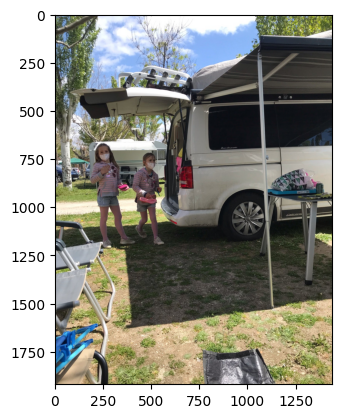

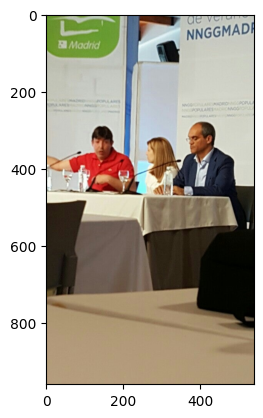

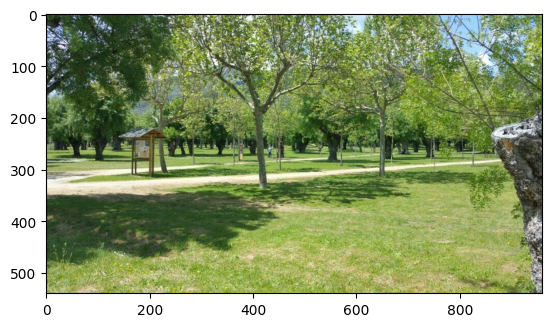

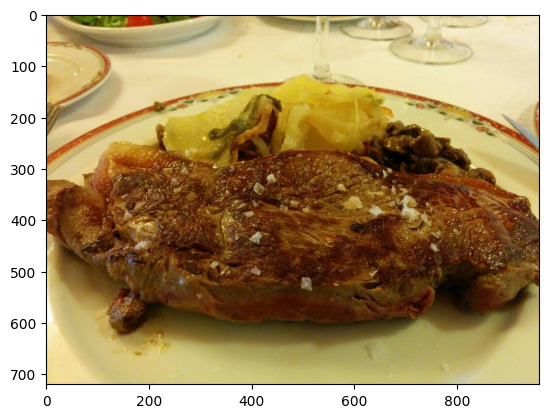

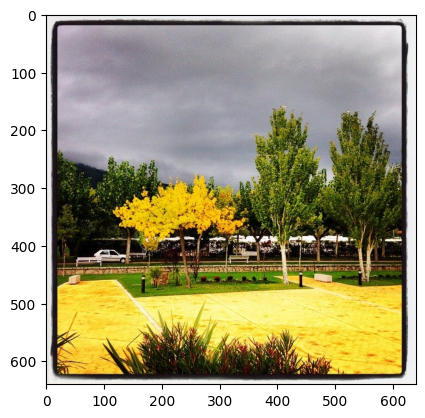

...

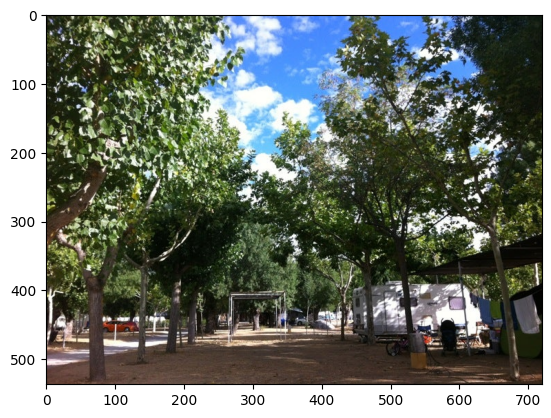

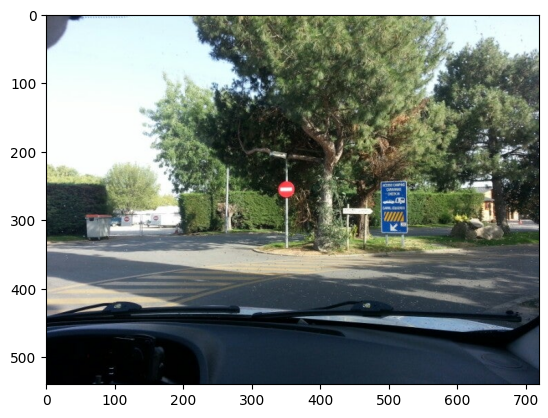

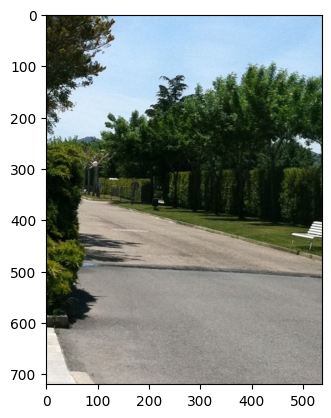

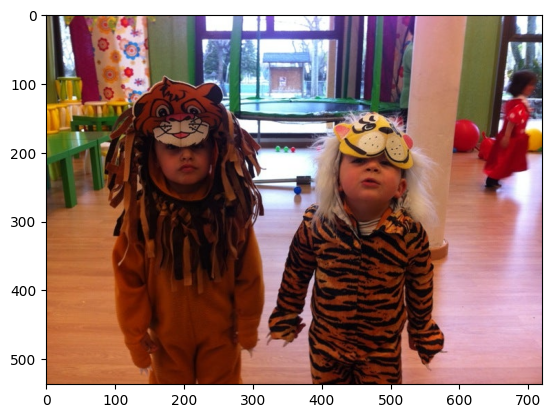

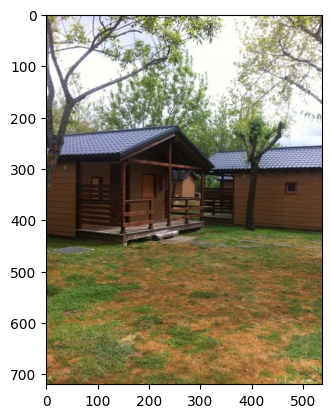

No devuelven el dinero si quieres cancelar una reserva por pandemia mundial declarada y estado de alarma en vigor. Te ofrecen aplazar la estancia a otras fechas pero no devuelven el dinero. Denunciaré
**************************************************
Creo sinceramente que es un buen camping. El Restaurante excelente y el servicio sensacional. El supermercado un poco caro. Las piscinas y la animación muy bien. Repetiremos sin duda alguna.
**************************************************
Es un campo de concentración, el cliente no entra en su vocabulario.
**************************************************
Buen sitio para pasar unas vacaciones en familia. La seguridad y el control excelente para los que buscamos tranquilidad. Seguro que volvemos.
**************************************************
Está muy muy bien. El personal es muy amable, digan lo que digan los "juerguistas" que piensan que el control es excesivo. Infringí levemente una norma para comprobarlo y el trato fue 100% ade

In [59]:
# Photos
fsq_id = "4b6432b9f964a520a8a32ae3"

url_params = {"limit"           : 50,
              "sort"            : "newest",
              "classifications" : None} 

details_url = f"https://api.foursquare.com/v3/places/{fsq_id}/photos"

headers = {"accept": "application/json", 
           "Authorization": credentials['clave_api']}

response = requests.get(url = details_url, params = url_params, headers = headers)

data = response.json()

image_data = list()

for r in data:
    image_id = r["id"]
    created_at = r["created_at"]
    prefix = r["prefix"] + "original" # Hay que agregar "original" al url para poder visualizarlo.
    suffix = r["suffix"]
    
    image_data.append([image_id, prefix + suffix, created_at])
    
df_image = pd.DataFrame(data = image_data, columns = ["id", "image_url", "created_at"])

for url in df_image["image_url"]:
    
    f = urllib.request.urlopen(url)

    a = plt.imread(f, format = f".{url.split('.')[-1]}")
    plt.imshow(a)
    plt.show()
    
################################################################################

# Tips
url_params = {"limit"  : 50,
              "fields" : "id,created_at,text,lang",
              "sort"   : "newest"} 

details_url = f"https://api.foursquare.com/v3/places/{fsq_id}/tips"

headers = {"accept": "application/json", 
           "Authorization": credentials['clave_api']}

response = requests.get(url = details_url, params = url_params, headers = headers)

data = response.json()

tips_data = list()

for r in data:
    tips_id = r["id"]
    created_at = r["created_at"]
    text = r["text"]
    lang = r["lang"]
    
    tips_data.append([text, lang, created_at, tips_id])
    
df_tips = pd.DataFrame(data = tips_data, columns = ["text", "lang", "created_at", "tips_id"])

for text in df_tips["text"]:
    
    print(text)
    print("*"*50)

In [ ]:
################################################################################################################################